In [2]:
file_path = '/Users/tanmaysagarhuria/Downloads/filtered_data_mimed0101.csv'

In [3]:
import pandas as pd

In [4]:
!pip install tensorflow

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.4/45.4 kB 8.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 589.8/589.8 MB 2.4 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 133.7/133.7 kB 23.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.6/5.6 MB 126.2 MB/s eta 0:00:0000:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.3/5.3 MB 107.2 MB/s eta 0:00:0000:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 92.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.5/24.5 MB 29.2 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 26.4 MB/s eta 0:00:00:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 65.5/65.5 kB 12.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 54.7 MB/s eta 0:00:00:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.1/5.1 MB 53.2 MB/s eta 0:00:00:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 80.3/80.3 kB 17.2 MB/s eta 0:00:00
   ━━━━━

In [12]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from sklearn.preprocessing import MinMaxScaler
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

In [13]:
bucket_name = 'lstm123'
file_path = 'filtered_data_mimed0101.csv'
s3_full_path = f's3://{bucket_name}/{file_path}'

In [14]:
df = pd.read_csv(s3_full_path)

In [8]:
print(df)

       Type  adjusted_time_ints     adjusted_time       Price     Volume
0       ask                 0.0   0 days 00:00:00  258.684211   2.000000
1       ask                 1.0   0 days 00:01:00  254.000000   5.000000
2       ask                 2.0   0 days 00:02:00  258.000000   1.000000
3       ask                 3.0   0 days 00:03:00  259.000000   4.000000
4       ask                 4.0   0 days 00:04:00  261.000000   2.000000
...     ...                 ...               ...         ...        ...
127495  bid             63745.0  44 days 06:25:00  112.000000   1.928571
127496  bid             63746.0  44 days 06:26:00  112.000000   2.600000
127497  bid             63747.0  44 days 06:27:00  113.000000   4.000000
127498  bid             63748.0  44 days 06:28:00  113.000000  10.000000
127499  bid             63749.0  44 days 06:29:00  112.000000   2.625000

[127500 rows x 5 columns]


In [15]:
import torch
import torch.nn as nn
import torch.optim as optim

In [16]:
scaler = MinMaxScaler(feature_range=(-1, 1))
df[['adjusted_time', 'Price', 'Volume']] = scaler.fit_transform(df[['adjusted_time_ints', 'Price', 'Volume']])

In [17]:
def create_inout_sequences(input_data, tw):
    inout_seq = []
    L = len(input_data)
    for i in range(L-tw):
        train_seq = input_data[i:i+tw]
        train_label = input_data[i+tw:i+tw+1, 1:]  # Shape [1, 2]
        inout_seq.append((train_seq ,train_label.squeeze()))  # Remove the unnecessary dimension
    return inout_seq

In [18]:
seq_length = 100

# Prepare the sequences including 'adjusted_time'
full_seq = df[['adjusted_time', 'Price', 'Volume']].values.astype(float)
inout_seq = create_inout_sequences(full_seq, seq_length)

In [19]:
inout_seq = [(torch.tensor(seq, dtype=torch.float), torch.tensor(label, dtype=torch.float)) for seq, label in inout_seq]

In [20]:
train_size = int(len(inout_seq) * 0.67)
train_seq = inout_seq[:train_size]
test_seq = inout_seq[train_size:]

In [21]:
from torch.utils.data import Dataset, DataLoader

class TimeSeriesDataset(Dataset):
    def __init__(self, sequences):
        self.sequences = sequences

    def __len__(self):
        return len(self.sequences)

    def __getitem__(self, index):
        sequence, label = self.sequences[index]
        return sequence, label

# Create dataset instances
train_dataset = TimeSeriesDataset(train_seq)
test_dataset = TimeSeriesDataset(test_seq)

# Create dataloaders
train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False)


In [22]:
class LSTMModel(nn.Module):
    def __init__(self, input_size, hidden_layer_size, output_size):
        super(LSTMModel, self).__init__()
        self.hidden_layer_size = hidden_layer_size
        self.lstm = nn.LSTM(input_size, hidden_layer_size, batch_first=True)
        self.linear = nn.Linear(hidden_layer_size, output_size)

    def forward(self, x):
        lstm_out, _ = self.lstm(x)
        predictions = self.linear(lstm_out[:, -1, :])  # Only take the output from the last sequence step
        return predictions

# Instantiate the model
model = LSTMModel(input_size=3, hidden_layer_size=100, output_size=2)


In [24]:
criterion = nn.MSELoss()  # Mean Squared Error Loss
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)


In [25]:
def train_model(model, train_loader, criterion, optimizer, epochs):
    model.train()  # Set the model to training mode
    
    for epoch in range(epochs):
        running_loss = 0.0
        
        for sequences, labels in train_loader:
            optimizer.zero_grad()  # Zero the parameter gradients
            
            # Forward pass
            outputs = model(sequences)
            loss = criterion(outputs, labels)
            
            # Backward pass and optimize
            loss.backward()
            optimizer.step()
            
            running_loss += loss.item()
        
        # Print statistics
        print(f'Epoch {epoch+1}/{epochs} Loss: {running_loss/len(train_loader):.4f}')
        
    print('Finished Training')

# Define the number of epochs
epochs = 30 # You can change this value depending on how long you want to train

# Call the training function
train_model(model, train_loader, criterion, optimizer, epochs)

Epoch 1/30 Loss: 0.0099
Epoch 2/30 Loss: 0.0044
Epoch 3/30 Loss: 0.0043
Epoch 4/30 Loss: 0.0043
Epoch 5/30 Loss: 0.0043
Epoch 6/30 Loss: 0.0043
Epoch 7/30 Loss: 0.0043
Epoch 8/30 Loss: 0.0042
Epoch 9/30 Loss: 0.0042
Epoch 10/30 Loss: 0.0042
Epoch 11/30 Loss: 0.0042
Epoch 12/30 Loss: 0.0042
Epoch 13/30 Loss: 0.0042
Epoch 14/30 Loss: 0.0042
Epoch 15/30 Loss: 0.0042
Epoch 16/30 Loss: 0.0042
Epoch 17/30 Loss: 0.0042
Epoch 18/30 Loss: 0.0041
Epoch 19/30 Loss: 0.0041
Epoch 20/30 Loss: 0.0041
Epoch 21/30 Loss: 0.0041
Epoch 22/30 Loss: 0.0041
Epoch 23/30 Loss: 0.0041
Epoch 24/30 Loss: 0.0041
Epoch 25/30 Loss: 0.0041
Epoch 26/30 Loss: 0.0041
Epoch 27/30 Loss: 0.0041
Epoch 28/30 Loss: 0.0041
Epoch 29/30 Loss: 0.0041
Epoch 30/30 Loss: 0.0041
Finished Training


In [26]:
def evaluate_model(model, test_loader, criterion):
    model.eval() 
    with torch.no_grad(): 
        test_loss = 0.0
        for sequences, labels in test_loader:
            outputs = model(sequences)
            loss = criterion(outputs, labels)
            test_loss += loss.item()
    return test_loss / len(test_loader)

In [27]:
test_loss = evaluate_model(model, test_loader, criterion)
print(f'Test Loss: {test_loss:.4f}')

Test Loss: 0.0104


In [28]:
def evaluate_model(model, test_loader, criterion):
    model.eval()
    with torch.no_grad():
        test_loss = 0.0
        all_predictions = []
        all_labels = []
        
        for sequences, labels in test_loader:
            outputs = model(sequences)
            loss = criterion(outputs, labels)
            test_loss += loss.item()
            
            # Store predictions and labels
            all_predictions.append(outputs)
            all_labels.append(labels)
            
        # Concatenate all predictions and labels
        all_predictions = torch.cat(all_predictions, dim=0)
        all_labels = torch.cat(all_labels, dim=0)
        
        return test_loss / len(test_loader), all_predictions, all_labels

# Now when you call evaluate_model, it will also return predictions and labels
test_loss, predictions, labels = evaluate_model(model, test_loader, criterion)
print(f'Test Loss: {test_loss:.4f}')


Test Loss: 0.0104


In [29]:
test_loss, all_predictions, all_labels = evaluate_model(model, test_loader, criterion)


In [30]:
mae = torch.nn.functional.l1_loss(all_predictions, all_labels, reduction='mean').item()
mse = torch.nn.functional.mse_loss(all_predictions, all_labels, reduction='mean').item()


In [31]:
print(f'Mean Absolute Error: {mae:.4f}')
print(f'Mean Squared Error: {mse:.4f}')

Mean Absolute Error: 0.0592
Mean Squared Error: 0.0104


In [32]:
test_loss, all_predictions, all_labels = evaluate_model(model, test_loader, criterion)

In [33]:
predictions_np = all_predictions.detach().cpu().numpy()
labels_np = all_labels.detach().cpu().numpy()

In [34]:
test_loss, all_predictions, all_labels = evaluate_model(model, test_loader, criterion)

In [35]:
print(f'Test Loss: {test_loss:.4f}')

Test Loss: 0.0104


In [36]:
from sklearn.metrics import mean_absolute_error, mean_squared_error

# Make sure to detach the tensors from GPU and convert them to numpy if necessary
all_predictions_np = all_predictions.detach().cpu().numpy()
all_labels_np = all_labels.detach().cpu().numpy()

mae = mean_absolute_error(all_labels_np, all_predictions_np)
mse = mean_squared_error(all_labels_np, all_predictions_np)
rmse = mse**0.5  # Square root of MSE

print(f'Mean Absolute Error: {mae:.4f}')
print(f'Root Mean Squared Error: {rmse:.4f}')

Mean Absolute Error: 0.0592
Root Mean Squared Error: 0.1021


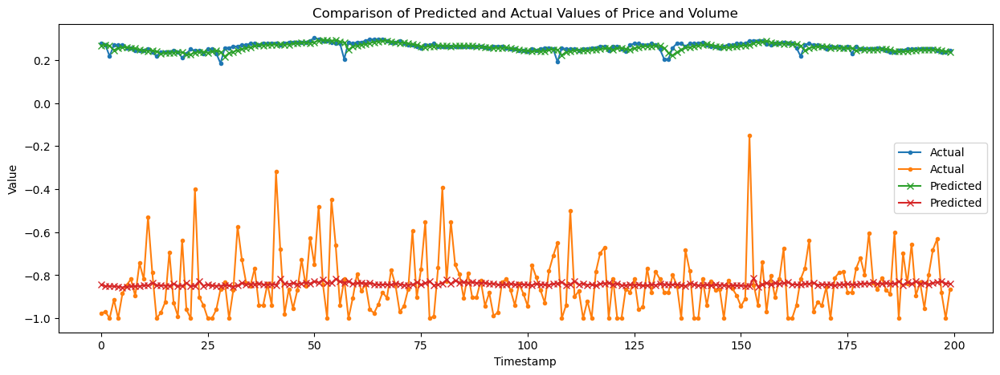

In [45]:
import matplotlib.pyplot as plt

# Plot the first 100 predictions and actual values for comparison
num_points_to_plot = 200  # Can be changed to whatever number you prefer
plt.figure(figsize=(15, 5))
plt.plot(all_labels_np[:num_points_to_plot], label='Actual', marker='.')
plt.plot(all_predictions_np[:num_points_to_plot], label='Predicted', marker='x')
plt.title('Comparison of Predicted and Actual Values of Price and Volume')
plt.xlabel('Timestamp')
plt.ylabel('Value')
plt.legend()
plt.show()

/home/ec2-user/anaconda3/envs/pytorch_p310/lib/python3.10/site-packages/sklearn/metrics/_regression.py:483: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/home/ec2-user/anaconda3/envs/pytorch_p310/lib/python3.10/site-packages/sklearn/metrics/_regression.py:483: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Price - Mean Absolute Error: 0.0209
Price - Root Mean Squared Error: 0.0272
Volume - Mean Absolute Error: 0.0975
Volume - Root Mean Squared Error: 0.1419


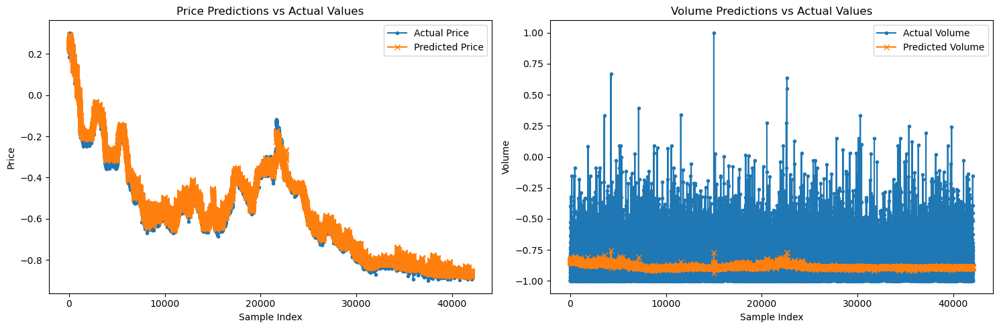

In [38]:
from sklearn.metrics import mean_absolute_error, mean_squared_error


prices_predictions = predictions_np[:, 0]  
volumes_predictions = predictions_np[:, 1]  
prices_actual = labels_np[:, 0]  
volumes_actual = labels_np[:, 1]  
price_mae = mean_absolute_error(prices_actual, prices_predictions)
price_rmse = mean_squared_error(prices_actual, prices_predictions, squared=False)

volume_mae = mean_absolute_error(volumes_actual, volumes_predictions)
volume_rmse = mean_squared_error(volumes_actual, volumes_predictions, squared=False)

print(f'Price - Mean Absolute Error: {price_mae:.4f}')
print(f'Price - Root Mean Squared Error: {price_rmse:.4f}')
print(f'Volume - Mean Absolute Error: {volume_mae:.4f}')
print(f'Volume - Root Mean Squared Error: {volume_rmse:.4f}')

plt.figure(figsize=(15, 5))
plt.subplot(1, 2, 1)
plt.plot(prices_actual, label='Actual Price', marker='.')
plt.plot(prices_predictions, label='Predicted Price', marker='x')
plt.title('Price Predictions vs Actual Values')
plt.xlabel('Sample Index')
plt.ylabel('Price')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(volumes_actual, label='Actual Volume', marker='.')
plt.plot(volumes_predictions, label='Predicted Volume', marker='x')
plt.title('Volume Predictions vs Actual Values')
plt.xlabel('Sample Index')
plt.ylabel('Volume')
plt.legend()

plt.tight_layout()
plt.show()


In [39]:
import numpy as np
import torch

def calculate_smape(actual, forecast):
    epsilon = np.finfo(np.float64).eps
    numerator = np.abs(forecast - actual)
    denominator = np.abs(actual) + np.abs(forecast) + epsilon
    smape = 2.0 * np.mean(numerator / denominator) * 100
    return smape

def calculate_mfe(actual, forecast):
    return np.mean(forecast - actual)

def calculate_cfe(actual, forecast):
    return np.sum(forecast - actual)

all_predictions_np = all_predictions.detach().cpu().numpy()
all_labels_np = all_labels.detach().cpu().numpy()

# Calculate the metrics for each feature
for i in range(all_predictions_np.shape[1]):  # Loop through each feature
    feature_pred = all_predictions_np[:, i]
    feature_true = all_labels_np[:, i]
    
    # Calculate and print sMAPE, MFE, and CFE for each feature
    feature_smape = calculate_smape(feature_true, feature_pred)
    feature_mfe = calculate_mfe(feature_true, feature_pred)
    feature_cfe = calculate_cfe(feature_true, feature_pred)
    
    print(f'sMAPE: {feature_smape:.4f}%')
    print(f'MFE: {feature_mfe:.4f}')
    print(f'CFE: {feature_cfe:.4f}\n')


sMAPE: 4.9746%
MFE: 0.0184
CFE: 772.2850

sMAPE: 12.3374%
MFE: -0.0433
CFE: -1818.9268



In [40]:
# Save the model locally
torch.save(model.state_dict(), 'LSTMFinalModel.pth')


In [41]:
import boto3

s3_client = boto3.client('s3')

# Define your bucket name and model path in S3
bucket_name = 'lstm123'
model_s3_path = 's3://lstm123/LSTMFinalModel'

# Upload the file
s3_client.upload_file('LSTMFinalModel.pth', bucket_name, model_s3_path)


In [42]:
import numpy as np

# Assuming all_predictions is a PyTorch tensor
predictions_np = all_predictions.detach().cpu().numpy()

# Save to CSV using numpy
np.savetxt("predictions.csv", predictions_np, delimiter=",", fmt='%f')


In [43]:
import pandas as pd

# Assuming all_predictions is a PyTorch tensor
predictions_np = all_predictions.detach().cpu().numpy()

# Create a DataFrame and save to CSV
predictions_df = pd.DataFrame(predictions_np, columns=['Pred_price', 'Pred_volume']) # Name the columns as needed
predictions_df.to_csv("predictions.csv", index=False)


In [63]:
import s3fs

# Write the DataFrame to a CSV in S3
fs = s3fs.S3FileSystem()
with fs.open(f's3://{bucket_name}/s3://lstm123/LSTMFinalModel/prediction.csv', 'w') as f:
    predictions_df.to_csv(f, index=False)


Trading Strategy Implementation:

In [46]:
import numpy as np

def apply_trading_strategy(predictions_np, labels_np, threshold=0.01):
    """
    Apply a simple trading strategy based on LSTM predictions.

    Parameters:
    - predictions: the first column is the predicted price, and the second column is the predicted volume.
    - actual_prices:
    - threshold: float, minimum relative change in price to trigger a trade.

    Returns:
    - trades: List of tuples, where each tuple is (trade_type, price, predicted_change).
    """
    trades = []
    
    for i in range(1, len(predictions_np)):
        predicted_change = (predictions[i, 0] - labels_np[i-1]) / labels_np[i-1]
        actual_change = (labels_np[i] - labels_np[i-1]) / labels_np[i-1]
        
        # Decide to buy if the predicted price increase is above the threshold
        if predicted_change > threshold:
            trades.append(('BUY', labels_np[i], predicted_change))
        
        # Decide to sell if the predicted price decrease is below the negative threshold
        elif predicted_change < -threshold:
            trades.append(('SELL', labels_np[i], predicted_change))
        
        # Optionally, you could add a HOLD decision, but typically no action is needed for hold
        # else:
        #     trades.append(('HOLD', actual_prices[i], predicted_change))

    return trades


Outputs:
trades: A list of tuples documenting each trade's type (BUY or SELL), the price at which the trade would occur, and the predicted change percentage.

Simulating the Trades
Create a function to simulate the financial impact of executing the trades generated by apply_trading_strategy.

In [47]:
def simulate_trades(trades, initial_capital):
    """
    Simulate trading based on trade signals and calculate the financial outcome.
    
    Parameters:
    - trades: list of tuples from apply_trading_strategy, each tuple is (trade_type, price, predicted_change)
    - initial_capital: float, the starting amount of money available for trading
    
    Returns:
    - final_capital: float, the resulting amount of money after completing the trades
    - portfolio: dict, a log of each trade and the resulting capital after the trade
    """
    capital = initial_capital
    portfolio = []
    
    for trade in trades:
        trade_type, price, predicted_change = trade
        if trade_type == 'BUY' and capital >= price:
            # Assuming one stock per buy for simplicity
            capital -= price  # subtract the price from capital to buy
            portfolio.append((trade_type, price, capital))
        elif trade_type == 'SELL':
            # Assuming you have the stock to sell
            capital += price  # add the price to capital from sale
            portfolio.append((trade_type, price, capital))
    
    final_capital = capital
    return final_capital, portfolio


In [48]:
# Example usage:
initial_capital = 10000  # starting with $10,000
predicted_prices = np.random.rand(100, 2)  # Dummy predicted prices and volumes
actual_prices = np.random.rand(100) * 100  # Dummy actual prices for 100 days

trades = apply_trading_strategy(predicted_prices, actual_prices)
final_capital, portfolio = simulate_trades(trades, initial_capital)

print(f"Starting Capital: ${initial_capital}")
print(f"Ending Capital: ${final_capital}")
for action, price, capital_remaining in portfolio:
    print(f"{action} at ${price:.2f}, Remaining Capital: ${capital_remaining:.2f}")


Starting Capital: $10000
Ending Capital: $14779.61707969431
SELL at $67.01, Remaining Capital: $10067.01
SELL at $30.41, Remaining Capital: $10097.41
SELL at $76.08, Remaining Capital: $10173.50
SELL at $48.66, Remaining Capital: $10222.15
SELL at $94.89, Remaining Capital: $10317.04
SELL at $97.54, Remaining Capital: $10414.58
SELL at $17.88, Remaining Capital: $10432.46
SELL at $83.03, Remaining Capital: $10515.49
SELL at $23.79, Remaining Capital: $10539.29
SELL at $22.27, Remaining Capital: $10561.56
SELL at $81.75, Remaining Capital: $10643.31
SELL at $75.29, Remaining Capital: $10718.60
SELL at $29.22, Remaining Capital: $10747.82
SELL at $55.61, Remaining Capital: $10803.42
SELL at $31.82, Remaining Capital: $10835.25
SELL at $91.62, Remaining Capital: $10926.87
SELL at $48.95, Remaining Capital: $10975.82
SELL at $48.00, Remaining Capital: $11023.82
SELL at $35.12, Remaining Capital: $11058.95
SELL at $57.76, Remaining Capital: $11116.71
SELL at $4.12, Remaining Capital: $11120

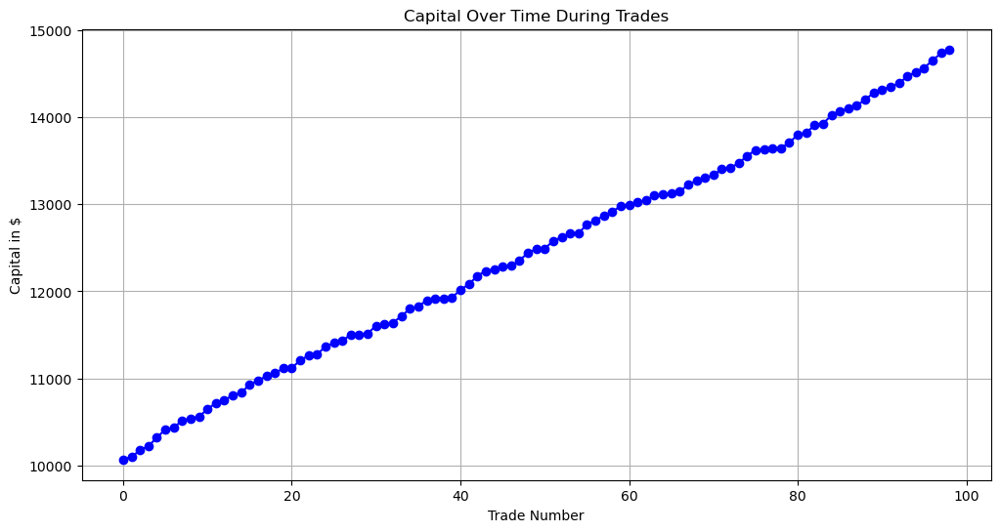

In [49]:
import matplotlib.pyplot as plt

capital_series = [entry[2] for entry in portfolio]


plt.figure(figsize=(12, 6))  # Set the figure size for better readability
plt.plot(capital_series, marker='o', linestyle='-', color='b')  
plt.title('Capital Over Time During Trades')  # Title of the plot
plt.xlabel('Trade Number')  # X-axis label
plt.ylabel('Capital in $')  # Y-axis label
plt.grid(True)  
plt.show() 


Extracting Data: The capital values are extracted from the portfolio, which records the state after each trade.
Plotting: The matplotlib.pyplot module is used to create the line plot. Adjustments like figure size, marker style, line style, and color are set for clarity and aesthetics.
Labels and Titles: Appropriate labels for the x-axis and y-axis, as well as a title for the plot, are added to make the graph informative.
Grid: A grid is enabled on the plot to make the visualization easier to interpret.

MACD Implementation:

In [55]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [56]:
df['EMA12'] = df['Price'].ewm(span=12, adjust=False).mean()
df['EMA26'] = df['Price'].ewm(span=26, adjust=False).mean()
df['MACD'] = df['EMA12'] - df['EMA26']
df['Signal'] = df['MACD'].ewm(span=9, adjust=False).mean()

In [58]:
df['Trade Signal'] = 0
df.loc[df['MACD'] > df['Signal'], 'Trade Signal'] = 1  # Buy
df.loc[df['MACD'] < df['Signal'], 'Trade Signal'] = -1  # Sell

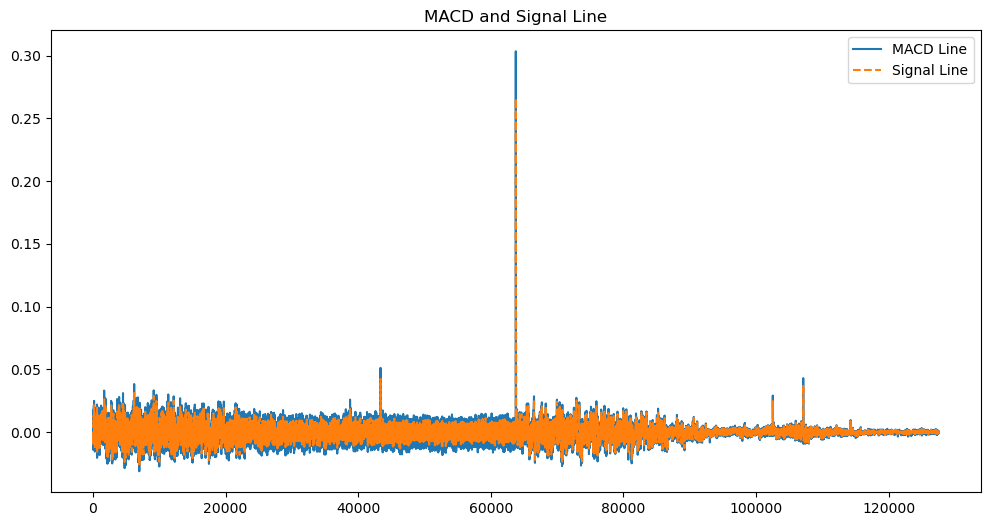

In [59]:
plt.figure(figsize=(12, 6))
df['MACD'].plot(label='MACD Line')
df['Signal'].plot(label='Signal Line', linestyle='--')
plt.legend()
plt.title('MACD and Signal Line')
plt.show()

In [60]:
initial_capital = 10000
capital = initial_capital
shares = 0

In [61]:
for i, row in df.iterrows():
    if row['Trade Signal'] == 1 and capital > 0:  # Buy
        shares = capital / row['Price']
        capital = 0
    elif row['Trade Signal'] == -1 and shares > 0:  # Sell
        capital = shares * row['Price']
        shares = 0

In [62]:
final_capital = capital if capital > 0 else shares * df.iloc[-1]['Price']
print(f"Initial Capital: ${initial_capital:.2f}")
print(f"Final Capital: ${final_capital:.2f}")

# Evaluate performance
profit = final_capital - initial_capital
print(f"Profit/Loss: ${profit:.2f}")

Initial Capital: $10000.00
Final Capital: $-0.00
Profit/Loss: $-10000.00


In [66]:
print(df) 

       Type  adjusted_time_ints  adjusted_time     Price    Volume     EMA12  \
0       ask                 0.0      -1.000000  0.090028 -0.939394  0.090028   
1       ask                 1.0      -0.999969  0.059211 -0.757576  0.085287   
2       ask                 2.0      -0.999937  0.085526 -1.000000  0.085323   
3       ask                 3.0      -0.999906  0.092105 -0.818182  0.086367   
4       ask                 4.0      -0.999875  0.105263 -0.939394  0.089274   
...     ...                 ...            ...       ...       ...       ...   
127495  bid             63745.0       0.999875 -0.875000 -0.943723 -0.874099   
127496  bid             63746.0       0.999906 -0.875000 -0.903030 -0.874237   
127497  bid             63747.0       0.999937 -0.868421 -0.818182 -0.873343   
127498  bid             63748.0       0.999969 -0.868421 -0.454545 -0.872585   
127499  bid             63749.0       1.000000 -0.875000 -0.901515 -0.872957   

           EMA26      MACD    Signal  T

In [67]:
predictions_df['macd_signal'] = (predictions_df['Pred_price'].ewm(span=12, adjust=False).mean() - 
                                 predictions_df['Pred_price'].ewm(span=26, adjust=False).mean()) - \
                                (predictions_df['Pred_price'].ewm(span=9, adjust=False).mean())

# Example of iterating through DataFrame correctly
for index, row in predictions_df.iterrows():
    price_prediction = row['Pred_price']
    macd_signal = row['macd_signal']
    # Here you can add logic based on price_prediction and macd_signal
    print(price_prediction, macd_signal)

0.267858624458313 -0.267858624458313
0.2682120203971863 -0.2679011125170607
0.26661911606788635 -0.26774437849217286
0.24540187418460846 -0.26506546757662847
0.25563377141952515 -0.26410208463514756
0.2577515244483948 -0.26354946259909323
0.2597772181034088 -0.26331690557055215
0.2558649480342865 -0.26263057700621023
0.25375357270240784 -0.26178990704522526
0.24701248109340668 -0.26026388358699193
0.24407093226909637 -0.25863052726924146
0.24187152087688446 -0.2569911087921574
0.24381808936595917 -0.25583767879432634
0.23885296285152435 -0.25424418735546983
0.22827491164207458 -0.2516126990766646
0.23253962397575378 -0.24991057028362287
0.2339954376220703 -0.24861951617266154
0.23449230194091797 -0.2475449883074106
0.2361828088760376 -0.24678985233261932
0.23489780724048615 -0.245938811765141
0.22478781640529633 -0.24395095288571023
0.22590558230876923 -0.2423844657667393
0.2341802567243576 -0.24201767703924545
0.23788981139659882 -0.2420816616555674
0.23822663724422455 -0.242098700137

In [68]:
def simulate_trades(df, initial_capital):
    capital = initial_capital
    shares = 0
    portfolio_values = []

    for index, row in df.iterrows():
        if row['macd_signal'] > 0 and row['Pred_price'] > row['Price']:  # Buy condition
            if capital > 0:  # Only buy if you have capital
                shares = capital / row['Price']
                capital = 0
                print(f"Buying shares at {row['Price']}, total shares: {shares}")
        elif row['macd_signal'] < 0 and row['Pred_price'] < row['Price']:  # Sell condition
            if shares > 0:  # Only sell if you have shares
                capital = shares * row['Price']
                shares = 0
                print(f"Selling shares at {row['Price']}, capital now: {capital}")
        
        # Record the portfolio value
        portfolio_value = capital + (shares * row['Price'])
        portfolio_values.append(portfolio_value)

    return portfolio_values


In [71]:
df['macd_signal'] = df['EMA12'] - df['EMA26']


In [73]:
print(predictions_df)

       Pred_price  Pred_volume  macd_signal
0        0.267859    -0.844586    -0.267859
1        0.268212    -0.850108    -0.267901
2        0.266619    -0.849999    -0.267744
3        0.245402    -0.851939    -0.265065
4        0.255634    -0.852168    -0.264102
...           ...          ...          ...
42037   -0.870381    -0.887188     0.864612
42038   -0.871189    -0.886136     0.865440
42039   -0.872894    -0.887109     0.866314
42040   -0.873951    -0.887441     0.867155
42041   -0.875237    -0.892279     0.868003

[42042 rows x 3 columns]


In [74]:
df['Pred_price'] = predictions_df['Pred_price']

In [75]:
print(df)

       Type  adjusted_time_ints  adjusted_time     Price    Volume     EMA12  \
0       ask                 0.0      -1.000000  0.090028 -0.939394  0.090028   
1       ask                 1.0      -0.999969  0.059211 -0.757576  0.085287   
2       ask                 2.0      -0.999937  0.085526 -1.000000  0.085323   
3       ask                 3.0      -0.999906  0.092105 -0.818182  0.086367   
4       ask                 4.0      -0.999875  0.105263 -0.939394  0.089274   
...     ...                 ...            ...       ...       ...       ...   
127495  bid             63745.0       0.999875 -0.875000 -0.943723 -0.874099   
127496  bid             63746.0       0.999906 -0.875000 -0.903030 -0.874237   
127497  bid             63747.0       0.999937 -0.868421 -0.818182 -0.873343   
127498  bid             63748.0       0.999969 -0.868421 -0.454545 -0.872585   
127499  bid             63749.0       1.000000 -0.875000 -0.901515 -0.872957   

           EMA26      MACD    Signal  T

In [76]:
def simulate_trades(df, initial_capital):
    capital = initial_capital
    shares = 0
    portfolio_values = []

    for index, row in df.iterrows():
        if row['macd_signal'] > 0 and row['Pred_price'] > row['Price']:  # Buy condition
            if capital > 0:  # Only buy if you have capital
                shares = capital / row['Price']
                capital = 0
                print(f"Buying shares at {row['Price']}, total shares: {shares}")
        elif row['macd_signal'] < 0 and row['Pred_price'] < row['Price']:  # Sell condition
            if shares > 0:  # Only sell if you have shares
                capital = shares * row['Price']
                shares = 0
                print(f"Selling shares at {row['Price']}, capital now: {capital}")
        
        # Record the portfolio value
        portfolio_value = capital + (shares * row['Price'])
        portfolio_values.append(portfolio_value)

    return portfolio_values

# Initial setup
initial_capital = 10000  # Starting capital
portfolio_values = simulate_trades(df, initial_capital)


Buying shares at 0.10526315789473673, total shares: 95000.0000000001
Selling shares at 0.25963345864661647, capital now: 24665.17857142859
Buying shares at 0.24342105263157876, total shares: 101327.22007722023
Selling shares at 0.3157894736842104, capital now: 31998.069498069533
Buying shares at 0.23026315789473673, total shares: 138963.04467733062
Selling shares at 0.23026315789473673, capital now: 31998.069498069533
Buying shares at 0.21052631578947345, total shares: 151990.83011583044
Selling shares at 0.21710526315789447, capital now: 32998.0091698842
Buying shares at -0.7530153508771932, total shares: -43821.16397951858


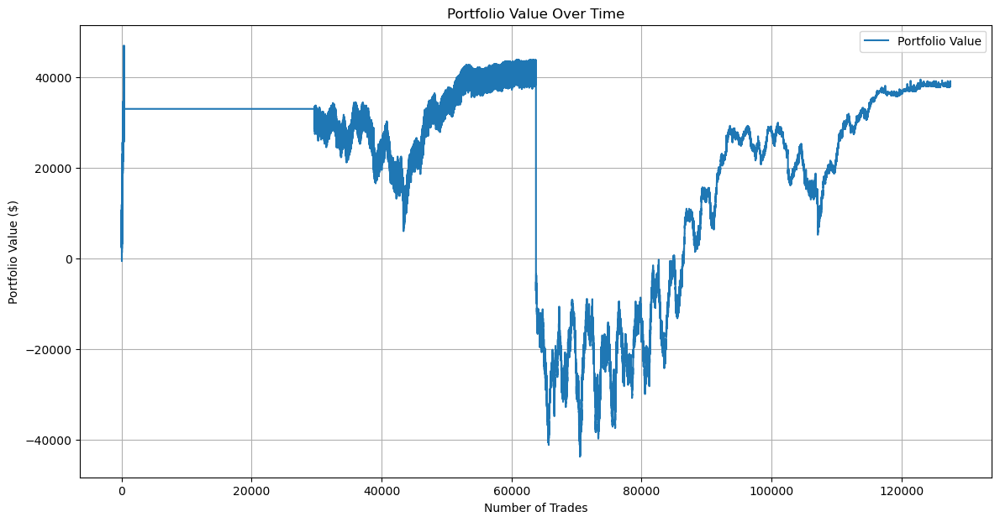

In [77]:
import matplotlib.pyplot as plt

# Plot the portfolio values
plt.figure(figsize=(14, 7))
plt.plot(portfolio_values, label='Portfolio Value')
plt.title('Portfolio Value Over Time')
plt.xlabel('Number of Trades')
plt.ylabel('Portfolio Value ($)')
plt.legend()
plt.grid(True)
plt.show()


In [78]:
# Check for NaN values in 'Pred_price' and handle them
if df['Pred_price'].isna().any():
    print("NaN values found in Pred_price. Handling...")
    df['Pred_price'].fillna(method='ffill', inplace=True)  # Forward fill method

# Now, run the simulation again if NaNs were handled
portfolio_values = simulate_trades(df, initial_capital)


NaN values found in Pred_price. Handling...
Buying shares at 0.10526315789473673, total shares: 95000.0000000001
Selling shares at 0.25963345864661647, capital now: 24665.17857142859
Buying shares at 0.24342105263157876, total shares: 101327.22007722023
Selling shares at 0.3157894736842104, capital now: 31998.069498069533
Buying shares at 0.23026315789473673, total shares: 138963.04467733062
Selling shares at 0.23026315789473673, capital now: 31998.069498069533
Buying shares at 0.21052631578947345, total shares: 151990.83011583044
Selling shares at 0.21710526315789447, capital now: 32998.0091698842
Buying shares at -0.7530153508771932, total shares: -43821.16397951858


In [79]:

final_portfolio_value = portfolio_values[-1] if portfolio_values else initial_capital

profit = final_portfolio_value - initial_capital

roi = (profit / initial_capital) * 100

print(f"Initial Capital: ${initial_capital:.2f}")
print(f"Final Portfolio Value: ${final_portfolio_value:.2f}")
print(f"Profit: ${profit:.2f}")
print(f"Return on Investment (ROI): {roi:.2f}%")


Initial Capital: $10000.00
Final Portfolio Value: $38343.52
Profit: $28343.52
Return on Investment (ROI): 283.44%


 Portfolio Value Over Time

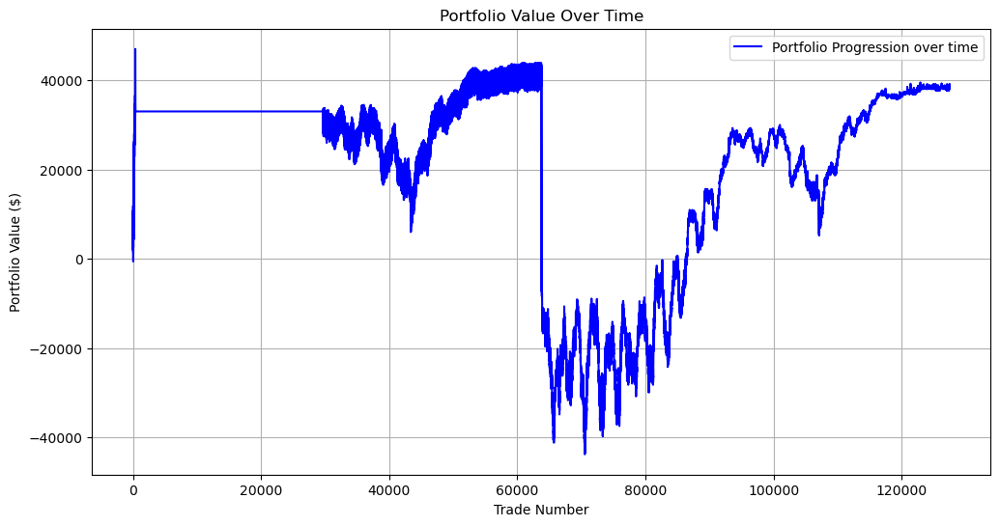

In [81]:
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 6))
plt.plot(portfolio_values, label='Portfolio Progression over time', color='blue')
plt.title('Portfolio Value Over Time')
plt.xlabel('Trade Number')
plt.ylabel('Portfolio Value ($)')
plt.legend()
plt.grid(True)
plt.show()


Buy and Sell Points on Price Chart

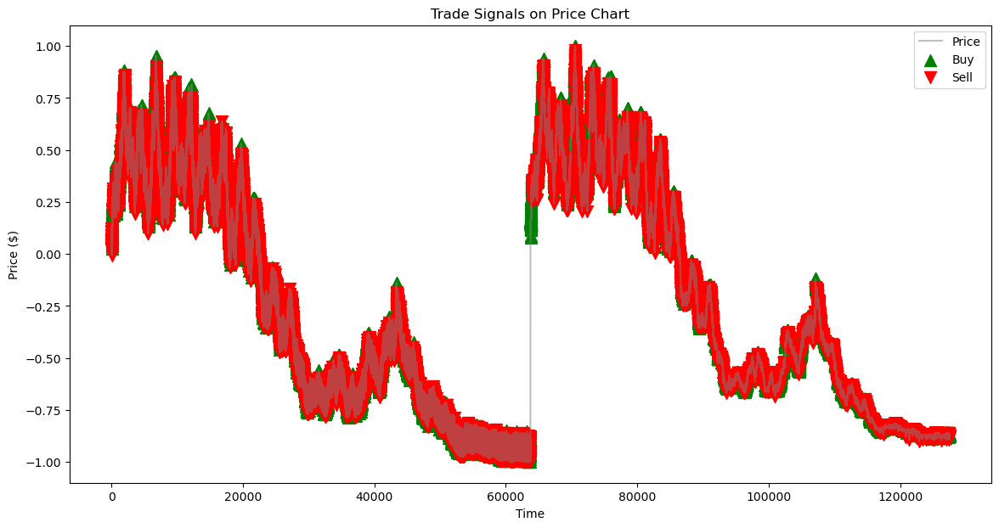

In [82]:
# Assuming df is your main DataFrame and it has 'Price', 'macd_signal', and 'Pred_price' columns
# Mark trades: Assuming you track buy/sell actions in df with 'action' column (1 for buy, -1 for sell)
df['action'] = 0
df.loc[df['macd_signal'] > 0, 'action'] = 1  # Buy
df.loc[df['macd_signal'] < 0, 'action'] = -1  # Sell

plt.figure(figsize=(14, 7))
plt.plot(df['Price'], label='Price', color='gray', alpha=0.5)
plt.scatter(df.index[df['action'] == 1], df['Price'][df['action'] == 1], color='green', label='Buy', marker='^', s=100)
plt.scatter(df.index[df['action'] == -1], df['Price'][df['action'] == -1], color='red', label='Sell', marker='v', s=100)
plt.title('Trade Signals on Price Chart')
plt.xlabel('Time')
plt.ylabel('Price ($)')
plt.legend()
plt.show()

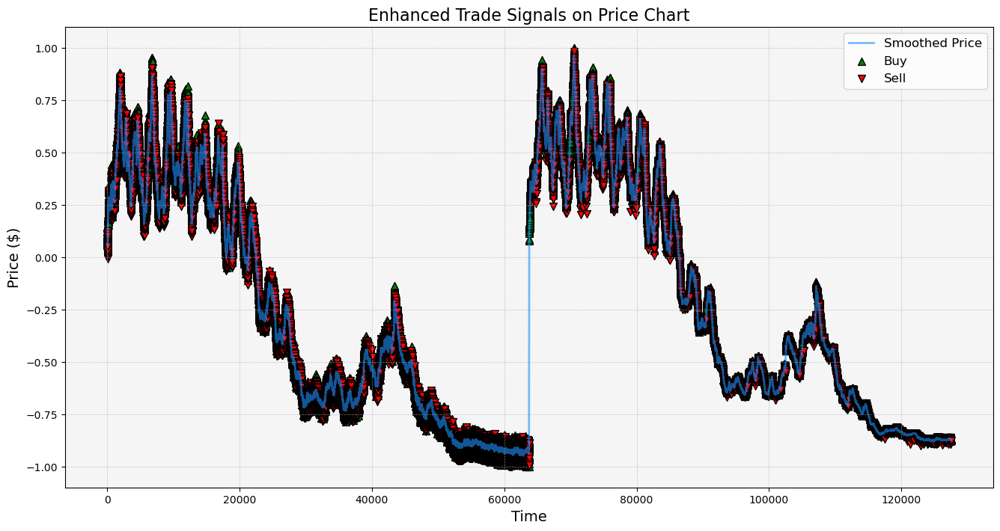

In [83]:
import matplotlib.pyplot as plt
import numpy as np

# Enhance the chart with better coloring and smoothed price line
plt.figure(figsize=(16, 8))

# Smooth the price data for better visualization
smoothed_price = np.convolve(df['Price'], np.ones((50,))/50, mode='valid')

# Plot smoothed price with a more appealing color and line style
plt.plot(df.index[24:-25], smoothed_price, label='Smoothed Price', color='dodgerblue', linewidth=2, alpha=0.6)

# Highlight buy and sell signals with distinct markers and colors
plt.scatter(df.index[df['action'] == 1], df['Price'][df['action'] == 1], color='green', label='Buy', marker='^', s=50, edgecolor='black')
plt.scatter(df.index[df['action'] == -1], df['Price'][df['action'] == -1], color='red', label='Sell', marker='v', s=50, edgecolor='black')

# Adding enhancements
plt.title('Enhanced Trade Signals on Price Chart', fontsize=16)
plt.xlabel('Time', fontsize=14)
plt.ylabel('Price ($)', fontsize=14)
plt.legend(fontsize=12)
plt.grid(True, which='both', linestyle='--', linewidth=0.5, alpha=0.7)

# Enhance visibility with a background color inside the plot area
ax = plt.gca()
ax.set_facecolor('whitesmoke')

plt.show()


Key Components Explained:
Trace for Price: The price data is added as a line chart. This is the base trace of the chart.
Buy and Sell Signals: These are added as scatter plots with specific markers:
Buy: Green triangles pointing up.
Sell: Red triangles pointing down.
Interactive Features:
Range Slider: Allows for zooming into specific portions of the data to examine finer details.
Hover Details: Moving your cursor over any point will show details about that point, improving data readability.
Layout Enhancements: Using the plotly_white template for a clean look, and adding titles for clarity.

In [87]:
import plotly.graph_objects as go

# Create a line chart for the prices
fig = go.Figure()

# Adding the price line
fig.add_trace(go.Scatter(x=df.index, y=df['Price'], mode='lines', name='Price', line=dict(color='blue')))

# Add buy signals
fig.add_trace(go.Scatter(x=df.index[df['action'] == 1], y=df['Price'][df['action'] == 1],
                         mode='markers', name='Buy', marker=dict(symbol='triangle-up', size=10, color='green')))

# Add sell signals
fig.add_trace(go.Scatter(x=df.index[df['action'] == -1], y=df['Price'][df['action'] == -1],
                         mode='markers', name='Sell', marker=dict(symbol='triangle-down', size=10, color='red')))

# Enhancements for better visualization
fig.update_layout(
    title='Interactive Trade Signals on Price Chart',
    xaxis_title='Time',
    yaxis_title='Price ($)',
    legend_title='Legend',
    template='plotly_white'
)

fig.update_xaxes(rangeslider_visible=True)
fig.show()


In [88]:
import matplotlib.pyplot as plt
from ipywidgets import interact, IntSlider
import numpy as np

# Simple function to plot a subset of the data
def plot_data(window_start=0, window_size=1000):
    window_end = window_start + window_size
    subset = df.iloc[window_start:window_end]

    plt.figure(figsize=(14, 7))
    plt.plot(subset.index, subset['Price'], label='Price', color='blue')
    
    # Highlight buy and sell signals within the window
    buys = subset[subset['action'] == 1]
    sells = subset[subset['action'] == -1]
    
    plt.scatter(buys.index, buys['Price'], color='green', label='Buy', marker='^', s=100, alpha=0.7)
    plt.scatter(sells.index, sells['Price'], color='red', label='Sell', marker='v', s=100, alpha=0.7)
    
    plt.title('Price and Trade Signals')
    plt.xlabel('Index')
    plt.ylabel('Price ($)')
    plt.legend()
    plt.grid(True)
    plt.show()

# Use interact to create slider widgets for window start and size
interact(plot_data, window_start=IntSlider(min=0, max=len(df)-1000, step=100, value=0), window_size=IntSlider(min=500, max=5000, step=500, value=1000))


interactive(children=(IntSlider(value=0, description='window_start', max=126500, step=100), IntSlider(value=10…

<function __main__.plot_data(window_start=0, window_size=1000)>

In [90]:
import matplotlib.pyplot as plt
from ipywidgets import interact, IntSlider
import numpy as np

# Function to plot data with enhancements
def plot_data(window_start=0, window_size=1000):
    window_end = window_start + window_size
    subset = df.iloc[window_start:window_end]

    plt.figure(figsize=(14, 7))
    
    # Smooth the price curve with a moving average
    subset['Price_MA'] = subset['Price'].rolling(window=20, min_periods=1).mean()
    
    # Plot smoothed price curve
    plt.plot(subset.index, subset['Price_MA'], label='Smoothed Price', color='blue')
    
    # Highlight buy and sell signals within the window
    buys = subset[subset['action'] == 1]
    sells = subset[subset['action'] == -1]
    
    # Increase marker size for better visibility
    plt.scatter(buys.index, buys['Price'], color='green', label='Buy', marker='^', s=150, alpha=0.7)
    plt.scatter(sells.index, sells['Price'], color='red', label='Sell', marker='v', s=150, alpha=0.7)
    
    # Add vertical lines for window boundaries
    plt.axvline(x=subset.index[0], color='gray', linestyle='--', linewidth=1)
    plt.axvline(x=subset.index[-1], color='gray', linestyle='--', linewidth=1)
    
    plt.title('Price and Trade Signals')
    plt.xlabel('Index')
    plt.ylabel('Price ($)')
    plt.legend()
    plt.grid(True)
    plt.show()

# Use interact to create slider widgets for window start and size
interact(plot_data, window_start=IntSlider(min=0, max=len(df)-1000, step=100, value=0), window_size=IntSlider(min=500, max=5000, step=500, value=1000))


interactive(children=(IntSlider(value=0, description='window_start', max=126500, step=100), IntSlider(value=10…

<function __main__.plot_data(window_start=0, window_size=1000)>

In [91]:
import matplotlib.pyplot as plt
from matplotlib.dates import DateFormatter
from ipywidgets import interact, IntSlider
import numpy as np

# Function to plot data with enhancements
def plot_data(window_start=0, window_size=1000):
    window_end = window_start + window_size
    subset = df.iloc[window_start:window_end]

    fig, ax1 = plt.subplots(figsize=(14, 7))

    # Smooth the price curve with a moving average
    subset['Price_MA'] = subset['Price'].rolling(window=20, min_periods=1).mean()

    # Plot smoothed price curve
    ax1.plot(subset.index, subset['Price_MA'], label='Smoothed Price', color='blue')
    ax1.set_xlabel('Date')
    ax1.set_ylabel('Price ($)')
    ax1.tick_params(axis='y', labelcolor='blue')

    # Highlight buy and sell signals within the window
    buys = subset[subset['action'] == 1]
    sells = subset[subset['action'] == -1]

    # Increase marker size for better visibility
    ax1.scatter(buys.index, buys['Price'], color='green', label='Buy', marker='^', s=150, alpha=0.7)
    ax1.scatter(sells.index, sells['Price'], color='red', label='Sell', marker='v', s=150, alpha=0.7)

    # Add volume bars
    ax2 = ax1.twinx()
    ax2.bar(subset.index, subset['Volume'], color='gray', alpha=0.5, width=0.5)
    ax2.set_ylabel('Volume', color='gray')
    ax2.tick_params(axis='y', labelcolor='gray')

    
    # Adjust plot margins
    fig.tight_layout()

    plt.title('Price and Trade Signals')
    plt.legend()
    plt.grid(True)
    plt.show()

# Use interact to create slider widgets for window start and size
interact(plot_data, window_start=IntSlider(min=0, max=len(df)-1000, step=100, value=0), window_size=IntSlider(min=500, max=5000, step=500, value=1000))


interactive(children=(IntSlider(value=0, description='window_start', max=126500, step=100), IntSlider(value=10…

<function __main__.plot_data(window_start=0, window_size=1000)>

In [94]:
import matplotlib.pyplot as plt
from matplotlib.dates import DateFormatter
from ipywidgets import interact, IntSlider
import numpy as np
from scipy.signal import find_peaks

# Function to plot data with enhancements
def plot_data(window_start=0, window_size=1000):
    window_end = window_start + window_size
    subset = df.iloc[window_start:window_end]

    fig, ax1 = plt.subplots(figsize=(14, 7))

    # Smooth the price curve with a moving average
    subset['Price_MA'] = subset['Price'].rolling(window=20, min_periods=1).mean()

    # Plot smoothed price curve
    ax1.plot(subset.index, subset['Price_MA'], label='Smoothed Price', color='blue')
    ax1.set_xlabel('Timestamp')
    ax1.set_ylabel('Price ($)')
    ax1.tick_params(axis='y', labelcolor='blue')

    # Highlight buy and sell signals within the window
    buys = subset[subset['action'] == 1]
    sells = subset[subset['action'] == -1]

    # Plot buy and sell signals with trend lines
    for signal, color in zip([buys, sells], ['green', 'red']):
        if not signal.empty:
            # Find peaks (highs or lows) in the signal
            peaks, _ = find_peaks(signal['Price'], height=0)
            if len(peaks) > 1:
                # Fit a linear trend line through the peaks
                coeffs = np.polyfit(peaks, signal['Price'].iloc[peaks], 1)
                trend_line = np.poly1d(coeffs)
                ax1.plot(subset.index[peaks], trend_line(peaks), linestyle='--', color=color)

            ax1.scatter(signal.index, signal['Price'], color=color, marker='o', s=150, alpha=0.7)

    # Add volume bars
    ax2 = ax1.twinx()
    ax2.bar(subset.index, subset['Volume'], color='gray', alpha=0.5, width=0.5)
    ax2.set_ylabel('Volume', color='gray')
    ax2.tick_params(axis='y', labelcolor='gray')


    # Adjust plot margins
    fig.tight_layout()

    plt.title('Price and Trade Signals with Trend Lines')
    plt.legend()
    plt.grid(True)
    plt.show()

# Use interact to create slider widgets for window start and size
interact(plot_data, window_start=IntSlider(min=0, max=len(df)-1000, step=100, value=0), window_size=IntSlider(min=500, max=5000, step=500, value=1000))


interactive(children=(IntSlider(value=0, description='window_start', max=126500, step=100), IntSlider(value=10…

<function __main__.plot_data(window_start=0, window_size=1000)>